# Stock Price Change Forecasting

This project aims to build predictive models for forecasting stock price change. The stock price change is calculated as the difference between the future stock price (at a specific time interval, such as minute, hour, or day) and the current stock price. In this assignment, stock price change is calculated as "Close" price of current time minus the "Close" price of previous latest time.

## Dataset

The dataset is composed of 4 files, each representing data from different stocks: PNJ, FPT, VIC, and MSN. These files contain historical stock data with the following columns:

- **Ticker**: The stock symbol or ticker identifier, which represents the company associated with the stock.
- **Date/Time**: The specific date and time when the stock data was recorded, providing a time series for the stock's performance.
- **Open**: The opening price of the stock at the beginning of the recorded period (minute, hour, or day).
- **High**: The highest price that the stock reached during the recorded period.
- **Low**: The lowest price that the stock dropped to during the recorded period.
- **Close**: The closing price of the stock at the end of the recorded period.
- **Volume**: The total number of shares traded during the recorded period, reflecting the activity and liquidity of the stock.
- **Open Interest**: The total number of outstanding derivative contracts, such as options or futures, that have not been settled or closed. This reflects market interest and speculation on the stock.


## The analysis will involve:

- **Data Preprocessing**
- **Feature Engineering**
- **Model Building**
- **Model Evaluation**

## Objective
The goal is to accurately predict the stock price fluctuation based on historical data using various predictive models.


## Load Dataset

In [1]:
# Load all the required libraries
import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt
import os   
from datetime import datetime, timedelta
import seaborn as snsrgew
import time 
import seaborn as sns
import plotly.graph_objects as go
import tensorflow as tf
from keras import Model
from keras.models import Sequential
from keras.layers import LSTM, Dense, Dropout, BatchNormalization
from keras.callbacks import ReduceLROnPlateau
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from sklearn.linear_model import LinearRegression
from xgboost import XGBRegressor
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split, TimeSeriesSplit
from keras.callbacks import ModelCheckpoint, TensorBoard
from sklearn.metrics import accuracy_score, precision_score, recall_score
from tensorflow.keras.metrics import Precision, Recall


In [2]:
# read data using Pandas DataFrame
def read_dataset(path):
    # Todo: read_csv from a path and return a DataFrame
    df = pd.read_csv(path)
    display(df.shape)
    display(df.head())
    display(df.info())
    display(df.describe())
    return df


In [3]:
# load data from my local directory
vic = read_dataset("VIC.csv")

(101266, 8)

,Ticker,Date/Time,Open,High,Low,Close,Volume,Open Interest
0,VIC,10/17/2018 9:39,98.5,98.5,98.5,98.5,390,0
1,VIC,10/17/2018 9:40,98.5,98.5,98.5,98.5,760,0
2,VIC,10/17/2018 9:41,98.6,98.6,98.6,98.6,2060,0
3,VIC,10/17/2018 9:42,98.6,98.6,98.6,98.6,5540,0
4,VIC,10/17/2018 9:43,98.6,98.7,98.6,98.7,760,0


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 101266 entries, 0 to 101265
Data columns (total 8 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   Ticker         101266 non-null  object 
 1   Date/Time      101266 non-null  object 
 2   Open           101266 non-null  float64
 3   High           101266 non-null  float64
 4   Low            101266 non-null  float64
 5   Close          101266 non-null  float64
 6   Volume         101266 non-null  int64  
 7   Open Interest  101266 non-null  int64  
dtypes: float64(4), int64(2), object(2)
memory usage: 6.2+ MB


None

,Open,High,Low,Close,Volume,Open Interest
count,101266.000000,101266.000000,101266.000000,101266.000000,1.012660e+05,101266.0
mean,105.376460,105.418519,105.334147,105.378791,3.182640e+03,0.0
std,11.543158,11.535584,11.552338,11.545054,1.469814e+04,0.0
min,68.000000,68.000000,68.000000,68.000000,1.000000e+01,0.0
25%,95.400000,95.400000,95.300000,95.400000,2.300000e+02,0.0
50%,105.300000,105.300000,105.200000,105.300000,1.020000e+03,0.0
75%,115.800000,115.900000,115.800000,115.800000,3.000000e+03,0.0
max,126.100000,126.500000,126.100000,126.500000,1.468390e+06,0.0


In [4]:
fpt = read_dataset('FPT.csv')


(97406, 8)

,Ticker,Date/Time,Open,High,Low,Close,Volume,Open Interest
0,FPT,12/25/2018 9:15,30.89,30.89,30.89,30.89,35410,0
1,FPT,12/25/2018 9:16,30.81,30.81,30.81,30.81,190,0
2,FPT,12/25/2018 9:17,30.74,30.81,30.74,30.74,1120,0
3,FPT,12/25/2018 9:18,30.74,30.74,30.74,30.74,2120,0
4,FPT,12/25/2018 9:19,30.74,30.74,30.74,30.74,22500,0


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 97406 entries, 0 to 97405
Data columns (total 8 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Ticker         97406 non-null  object 
 1   Date/Time      97406 non-null  object 
 2   Open           97406 non-null  float64
 3   High           97406 non-null  float64
 4   Low            97406 non-null  float64
 5   Close          97406 non-null  float64
 6   Volume         97406 non-null  int64  
 7   Open Interest  97406 non-null  int64  
dtypes: float64(4), int64(2), object(2)
memory usage: 5.9+ MB


None

,Open,High,Low,Close,Volume,Open Interest
count,97406.000000,97406.000000,97406.000000,97406.000000,9.740600e+04,97406.0
mean,45.071630,45.090138,45.051430,45.071631,8.044173e+03,0.0
std,6.359803,6.364950,6.354245,6.359799,1.753203e+04,0.0
min,30.250000,30.250000,30.220000,30.250000,1.000000e+01,0.0
25%,39.740000,39.740000,39.700000,39.740000,7.500000e+02,0.0
50%,46.950000,46.950000,46.950000,46.950000,2.960000e+03,0.0
75%,49.200000,49.250000,49.170000,49.200000,8.960000e+03,0.0
max,58.400000,58.500000,58.400000,58.400000,1.255930e+06,0.0


In [5]:
pnj = read_dataset('PNJ.csv')

(125309, 8)

,Ticker,Date/Time,Open,High,Low,Close,Volume,Open Interest
0,PNJ,2/28/2018 9:15,78.14,78.99,78.14,78.99,270,0
1,PNJ,2/28/2018 9:16,78.94,78.94,78.94,78.94,10,0
2,PNJ,2/28/2018 9:19,78.14,78.14,78.14,78.14,283,0
3,PNJ,2/28/2018 9:20,78.14,78.14,78.14,78.14,480,0
4,PNJ,2/28/2018 9:21,78.14,78.14,78.14,78.14,146,0


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 125309 entries, 0 to 125308
Data columns (total 8 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   Ticker         125309 non-null  object 
 1   Date/Time      125309 non-null  object 
 2   Open           125309 non-null  float64
 3   High           125309 non-null  float64
 4   Low            125309 non-null  float64
 5   Close          125309 non-null  float64
 6   Volume         125309 non-null  int64  
 7   Open Interest  125309 non-null  int64  
dtypes: float64(4), int64(2), object(2)
memory usage: 7.6+ MB


None

,Open,High,Low,Close,Volume,Open Interest
count,125309.000000,125309.000000,125309.000000,125309.000000,125309.000000,125309.0
mean,72.182052,72.372590,72.042287,72.179371,3031.830451,0.0
std,9.900263,9.995786,9.830847,9.899401,7248.952968,0.0
min,44.430000,44.530000,44.040000,44.140000,1.000000,0.0
25%,64.600000,64.700000,64.570000,64.600000,220.000000,0.0
50%,72.800000,73.010000,72.640000,72.830000,1000.000000,0.0
75%,80.160000,80.350000,80.060000,80.160000,3130.000000,0.0
max,100.160000,100.160000,100.160000,100.160000,580730.000000,0.0


In [6]:
msn = read_dataset('MSN.csv')


(135354, 8)

,Ticker,Date/Time,Open,High,Low,Close,Volume,Open Interest
0,MSN,12/25/2017 9:15,73.1,73.1,73.1,73.1,4210,0
1,MSN,12/25/2017 9:16,73.0,73.0,73.0,73.0,5000,0
2,MSN,12/25/2017 9:18,73.5,73.5,73.5,73.5,210,0
3,MSN,12/25/2017 9:20,73.2,73.5,73.1,73.1,2050,0
4,MSN,12/25/2017 9:21,73.0,73.0,73.0,73.0,1380,0


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 135354 entries, 0 to 135353
Data columns (total 8 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   Ticker         135354 non-null  object 
 1   Date/Time      135354 non-null  object 
 2   Open           135354 non-null  float64
 3   High           135354 non-null  float64
 4   Low            135354 non-null  float64
 5   Close          135354 non-null  float64
 6   Volume         135354 non-null  int64  
 7   Open Interest  135354 non-null  int64  
dtypes: float64(4), int64(2), object(2)
memory usage: 8.3+ MB


None

,Open,High,Low,Close,Volume,Open Interest
count,135354.000000,135354.000000,135354.000000,135354.000000,1.353540e+05,135354.0
mean,74.878809,74.931668,74.834625,74.880759,5.683578e+03,0.0
std,15.418074,15.426954,15.412677,15.418857,2.798513e+04,0.0
min,46.500000,46.500000,46.400000,46.400000,1.000000e+01,0.0
25%,57.900000,57.900000,57.800000,57.800000,5.000000e+02,0.0
50%,79.100000,79.200000,79.100000,79.100000,2.000000e+03,0.0
75%,86.000000,86.100000,86.000000,86.000000,5.560000e+03,0.0
max,117.800000,118.000000,117.700000,118.000000,3.300680e+06,0.0


## EDA

In [7]:
files = {
    'vic': vic, 
    'msn': msn, 
    'pnj': pnj, 
    'fpt': fpt}

In [8]:
# to calculate duplicate
def remove_duplicates_and_report(df, name):
    num_duplicates = df.duplicated().sum()
    if num_duplicates > 0:
        df.drop_duplicates(inplace=True)
        print(f"{name} had {num_duplicates} duplicate rows, which have been removed.")
    else:
        print(f"{name} has no duplicate rows.")
    return df

# to calculate nunique of 'Open Interest'
def calculate_nunique_open_interest(df, name,col):
    if col in df.columns:
        num_unique = df[col].nunique()
        print(f"{name} has {num_unique} unique values in the {col} column.")
    else:
        print(f"{name} does not have the {col} column.")

for name, df in files.items():
    df = remove_duplicates_and_report(df, name)
    
    # Tính nunique của cột 'Open Interest'
    calculate_nunique_open_interest(df, name,"Open Interest")
    print("----")


vic has no duplicate rows.
vic has 1 unique values in the Open Interest column.
----
msn has no duplicate rows.
msn has 1 unique values in the Open Interest column.
----
pnj has no duplicate rows.
pnj has 1 unique values in the Open Interest column.
----
fpt has no duplicate rows.
fpt has 1 unique values in the Open Interest column.
----


The data is clean, there are no duplicate rows in the DataFrames. However, the `Open Interest` column in all the DataFrames has only 1 unique value, which shows that this column does not provide useful information for analysis or modeling.

In [9]:
# Column to drop
column_to_drop = 'Open Interest'

# Drop 'Open Interest' column from all DataFrames in the 'files' dictionary
for name, df in files.items():
    if column_to_drop in df.columns:
        df.drop(columns=[column_to_drop], inplace=True)
        print(f"{name}: The column '{column_to_drop}' has been removed.")
    else:
        print(f"{name}: The column '{column_to_drop}' does not exist.")


vic: The column 'Open Interest' has been removed.
msn: The column 'Open Interest' has been removed.
pnj: The column 'Open Interest' has been removed.
fpt: The column 'Open Interest' has been removed.


In [10]:
 # convert Date/Time column into suitable data type.
 # Convert 'Date/Time' column to datetime in all DataFrames in the 'files' dictionary
for name, df in files.items():
    if 'Date/Time' in df.columns:
        df['Date/Time'] = pd.to_datetime(df['Date/Time'], errors='coerce')
        print(f"Converted 'Date/Time' column to datetime for {name}")
    else:
        print(f"'{name}' does not have a 'Date/Time' column.")


Converted 'Date/Time' column to datetime for vic
Converted 'Date/Time' column to datetime for msn
Converted 'Date/Time' column to datetime for pnj
Converted 'Date/Time' column to datetime for fpt


In [11]:
vic.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 101266 entries, 0 to 101265
Data columns (total 7 columns):
 #   Column     Non-Null Count   Dtype         
---  ------     --------------   -----         
 0   Ticker     101266 non-null  object        
 1   Date/Time  101266 non-null  datetime64[ns]
 2   Open       101266 non-null  float64       
 3   High       101266 non-null  float64       
 4   Low        101266 non-null  float64       
 5   Close      101266 non-null  float64       
 6   Volume     101266 non-null  int64         
dtypes: datetime64[ns](1), float64(4), int64(1), object(1)
memory usage: 5.4+ MB


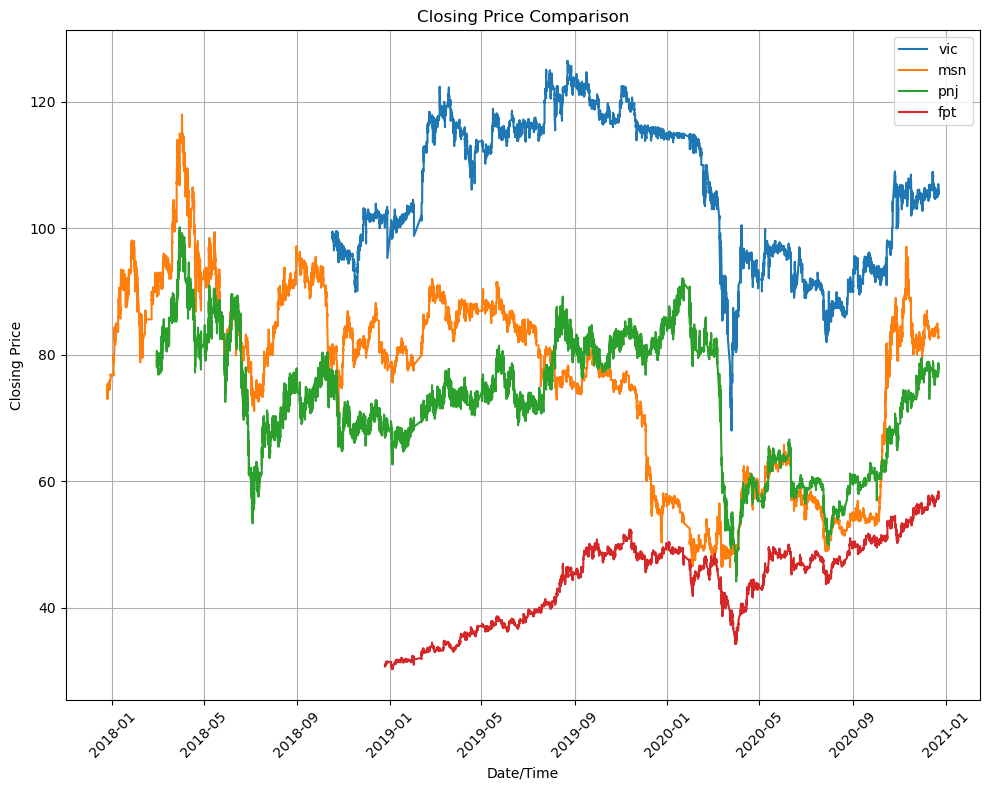

In [12]:

# Define a function to plot Closing Price Comparison
def plot_closing_price_comparison(files):
    plt.figure(figsize=(10, 8))  
    
    for name, df in files.items():
        if 'Date/Time' in df.columns and 'Close' in df.columns:
            plt.plot(df['Date/Time'], df['Close'], label=name)
        else:
            print(f"'{name}' does not have the required 'Date/Time' or 'Close' columns.")
    
    plt.title('Closing Price Comparison')
    plt.xlabel('Date/Time')
    plt.ylabel('Closing Price')
    plt.legend()
    plt.grid(True)
    plt.xticks(rotation=45)  # Rotate date labels for better readability
    plt.tight_layout()  # Adjust layout to fit all elements
    plt.show()

# Call the function to plot the comparison
plot_closing_price_comparison(files)


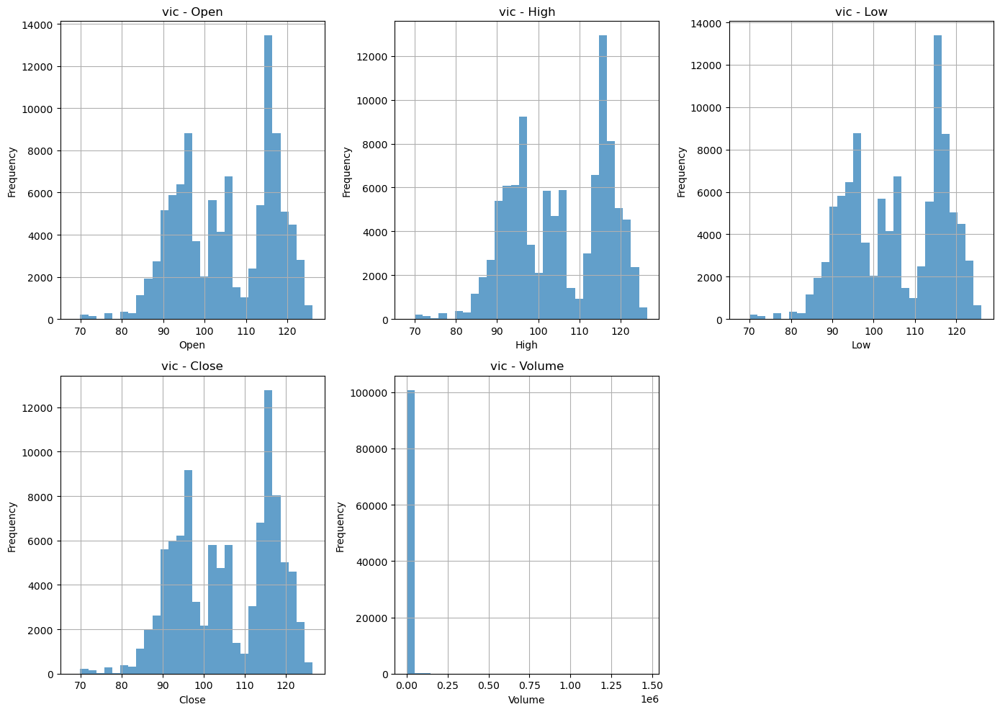

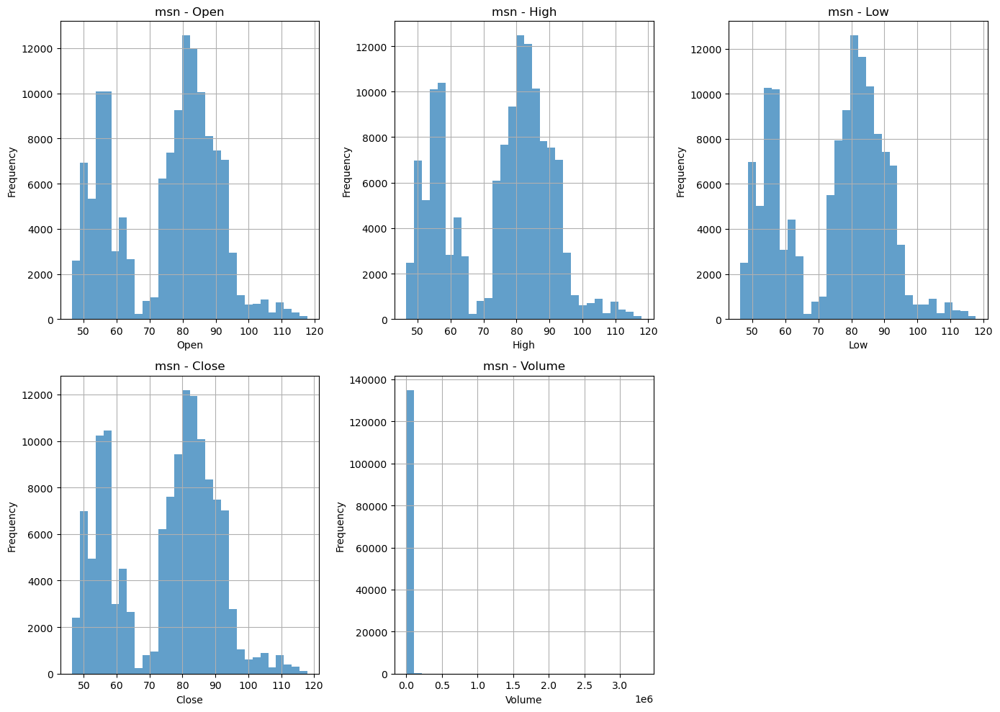

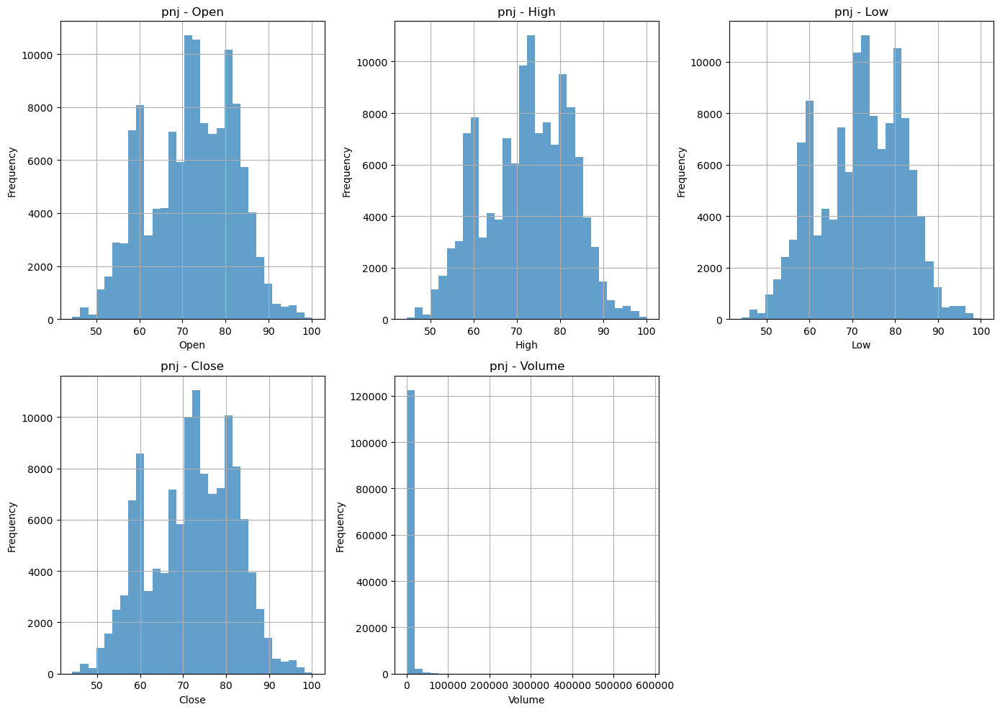

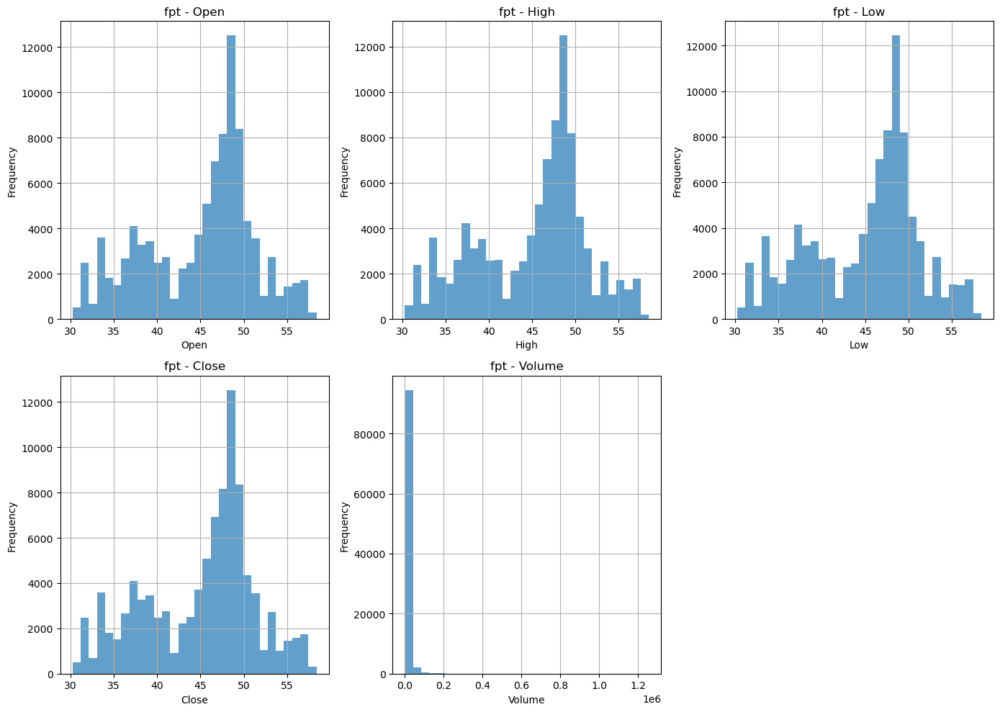

In [13]:

# Define a function to plot histograms for all specified columns
def plot_histograms(files):
    columns_to_plot = ['Open', 'High', 'Low', 'Close', 'Volume']
    
    for name, df in files.items():
        plt.figure(figsize=(14, 10))
        
        for i, col in enumerate(columns_to_plot):
            if col in df.columns:
                plt.subplot(2, 3, i + 1)
                plt.hist(df[col].dropna(), bins=30, alpha=0.7)
                plt.title(f'{name} - {col}')
                plt.xlabel(col)
                plt.ylabel('Frequency')
                plt.grid(True)
            else:
                print(f"'{name}' does not have the '{col}' column.")
        
        plt.tight_layout()
        plt.show()

# Call the function to plot histograms
plot_histograms(files)


In [14]:
df_combined = pd.concat([fpt, vic, pnj, msn])
df_combined

,Ticker,Date/Time,Open,High,Low,Close,Volume
0,FPT,2018-12-25 09:15:00,30.89,30.89,30.89,30.89,35410
1,FPT,2018-12-25 09:16:00,30.81,30.81,30.81,30.81,190
2,FPT,2018-12-25 09:17:00,30.74,30.81,30.74,30.74,1120
3,FPT,2018-12-25 09:18:00,30.74,30.74,30.74,30.74,2120
4,FPT,2018-12-25 09:19:00,30.74,30.74,30.74,30.74,22500
...,...,...,...,...,...,...,...
135349,MSN,2020-12-22 14:23:00,82.80,82.80,82.80,82.80,700
135350,MSN,2020-12-22 14:24:00,82.70,82.80,82.70,82.80,4660
135351,MSN,2020-12-22 14:25:00,82.80,82.80,82.80,82.80,50
135352,MSN,2020-12-22 14:27:00,82.80,82.80,82.80,82.80,300


In [15]:
df_pivot = df_combined.pivot_table(values='Close', index='Date/Time', columns='Ticker')

correlation_matrix = df_pivot.corr()

print("Correlation Matrix of Stock Closing Prices:")
print(correlation_matrix)


Correlation Matrix of Stock Closing Prices:
Ticker       FPT       MSN       PNJ       VIC
Ticker                                        
FPT     1.000000 -0.193125  0.123339 -0.156033
MSN    -0.193125  1.000000  0.508890  0.558858
PNJ     0.123339  0.508890  1.000000  0.872710
VIC    -0.156033  0.558858  0.872710  1.000000


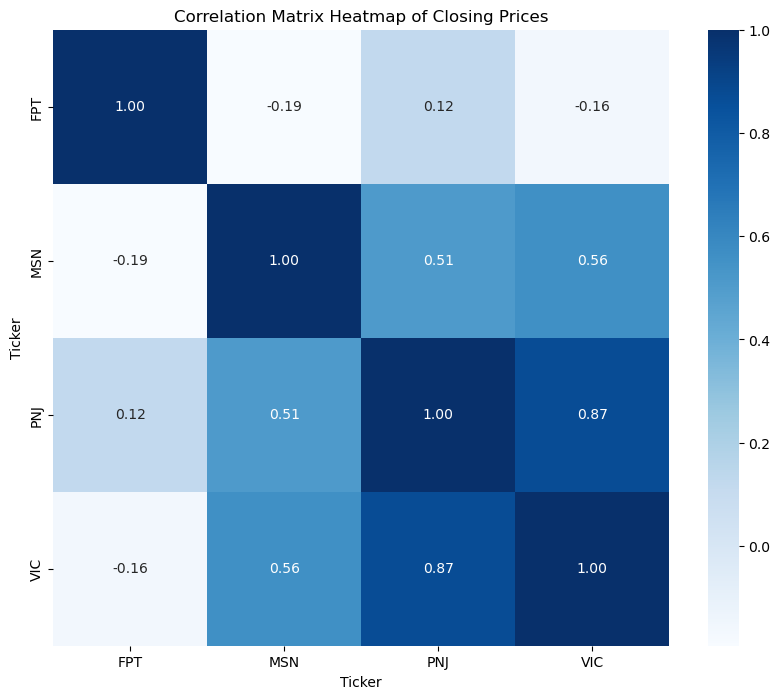

In [16]:
# Plot the heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap="Blues", square=True, fmt=".2f")
plt.title('Correlation Matrix Heatmap of Closing Prices')
plt.show()

Conclusions from the Correlation Matrix:

1. **Strong Positive Correlation:**
   - **PNJ and VIC (0.87):** They have a strong positive correlation, indicating that their closing prices move together closely.

2. **Low or Negative Correlation:**
   - **FPT with Others:** FPT shows low or negative correlations with other stocks, suggesting that its price movements are relatively independent of those of MSN, PNJ, and VIC.

These insights can aid in portfolio diversification, risk management, and identifying potential investment opportunities based on stock price relationships.


In [17]:

# Function to process data and plot candlestick chart with moving averages
def plot_candlestick_with_ma(df, ticker_name, ma_short=5, ma_medium=20, ma_long=50, num_rows=300):
    # Convert 'Date/Time' column to datetime format
    df['Date/Time'] = pd.to_datetime(df['Date/Time'])
    
    # Set 'Date/Time' as index
    df.set_index('Date/Time', inplace=True)
    
    # Resample to daily frequency and aggregate data
    df_daily = df.resample('D').agg(
        {
            'Open': 'first', 
            'High': 'max', 
            'Low': 'min', 
            'Close': 'last', 
            'Volume': 'sum'
        }
    )
    
    df_daily.dropna(inplace=True)

    
    # Calculate moving averages
    df_daily['MA_Short'] = df_daily['Close'].rolling(window=ma_short).mean()
    df_daily['MA_Medium'] = df_daily['Close'].rolling(window=ma_medium).mean()
    df_daily['MA_Long'] = df_daily['Close'].rolling(window=ma_long).mean()
    
    # Select the last `num_rows` rows for plotting
    df_plot = df_daily.tail(num_rows)
    
    # Plot the candlestick chart
    fig = go.Figure(data=[go.Candlestick(
        x=df_plot.index,
        open=df_plot['Open'],
        high=df_plot['High'],
        low=df_plot['Low'],
        close=df_plot['Close'],
        name='Candlesticks'
    )])
    
    # Add moving average lines
    fig.add_trace(go.Scatter(x=df_plot.index, y=df_plot['MA_Short'], mode='lines', name=f'MA {ma_short}'))
    fig.add_trace(go.Scatter(x=df_plot.index, y=df_plot['MA_Medium'], mode='lines', name=f'MA {ma_medium}'))
    fig.add_trace(go.Scatter(x=df_plot.index, y=df_plot['MA_Long'], mode='lines', name=f'MA {ma_long}'))
    
    # Customize layout
    fig.update_layout(
        title=f'{ticker_name} Candlestick Chart with Moving Averages',
        xaxis_title='Date',
        yaxis_title='Price',
        xaxis_rangeslider_visible=False
    )
    
    # Show the plot
    fig.show()

# Load the data for all four tickers (PNJ, FPT, VIC, MSN)
# Giả sử rằng các DataFrame đã được đọc từ file và có tên tương ứng: pnj, fpt, vic, msn

# Example usage for each file (showing only the last 300 rows for each):
plot_candlestick_with_ma(pnj, "PNJ", num_rows=300)
plot_candlestick_with_ma(fpt, "FPT", num_rows=300)
plot_candlestick_with_ma(vic, "VIC", num_rows=300)
plot_candlestick_with_ma(msn, "MSN", num_rows=300)


In [18]:
vic

,Ticker,Open,High,Low,Close,Volume
Date/Time,,,,,,
2018-10-17 09:39:00,VIC,98.5,98.5,98.5,98.5,390
2018-10-17 09:40:00,VIC,98.5,98.5,98.5,98.5,760
2018-10-17 09:41:00,VIC,98.6,98.6,98.6,98.6,2060
2018-10-17 09:42:00,VIC,98.6,98.6,98.6,98.6,5540
2018-10-17 09:43:00,VIC,98.6,98.7,98.6,98.7,760
...,...,...,...,...,...,...
2020-12-22 14:22:00,VIC,105.8,105.8,105.7,105.7,1870
2020-12-22 14:23:00,VIC,105.7,105.7,105.7,105.7,2510
2020-12-22 14:24:00,VIC,105.7,105.7,105.7,105.7,3620


In [19]:
# Define a function to calculate price movement
def calculate_price_movement(df):
    # Calculate price change as the difference between consecutive close prices
    df['Price_Movement'] = df['Close'].shift(-1) - df['Close']
    
    # Drop rows with NaN values in 'Price_Movement'
    #df = df.dropna(subset=['Price_Movement'])
    
    return df

# Apply price movement calculation
for key in files.keys():
    files[key] = calculate_price_movement(files[key])

In [20]:
vic

,Ticker,Open,High,Low,Close,Volume,Price_Movement
Date/Time,,,,,,,
2018-10-17 09:39:00,VIC,98.5,98.5,98.5,98.5,390,0.0
2018-10-17 09:40:00,VIC,98.5,98.5,98.5,98.5,760,0.1
2018-10-17 09:41:00,VIC,98.6,98.6,98.6,98.6,2060,0.0
2018-10-17 09:42:00,VIC,98.6,98.6,98.6,98.6,5540,0.1
2018-10-17 09:43:00,VIC,98.6,98.7,98.6,98.7,760,0.0
...,...,...,...,...,...,...,...
2020-12-22 14:22:00,VIC,105.8,105.8,105.7,105.7,1870,0.0
2020-12-22 14:23:00,VIC,105.7,105.7,105.7,105.7,2510,0.0
2020-12-22 14:24:00,VIC,105.7,105.7,105.7,105.7,3620,0.0


### What is Return?

In financial terms, **return** represents the percentage change in the price of a stock from one period to the next. It measures the gain or loss relative to the initial price. The return can be calculated on a daily, weekly, or any other periodic basis.

The formula for calculating return is:

Return = ((Current Price - Previous Price) / Previous Price) × 100%


In [21]:
import pandas as pd
import plotly.graph_objects as go

# Function to calculate returns
def calculate_returns(df):
    df['Return'] = df['Close'].pct_change() * 100
    return df

# Calculate returns for each stock
for key in files.keys():
    files[key] = calculate_returns(files[key])

# Plot returns for each stock separately
for key in files.keys():
    # Create a figure for the current stock
    fig = go.Figure()
    
    # Extract positive and negative returns
    positive_returns = files[key][files[key]['Return'] >= 0]
    negative_returns = files[key][files[key]['Return'] < 0]
    
    # Plot positive returns
    fig.add_trace(go.Scatter(
        x=positive_returns.index,
        y=positive_returns['Return'],
        mode='lines',
        name='Positive Return',
        line=dict(color='green')
    ))
    
    # Plot negative returns
    fig.add_trace(go.Scatter(
        x=negative_returns.index,
        y=negative_returns['Return'],
        mode='lines',
        name='Negative Return',
        line=dict(color='red')
    ))
    
    # Customize layout
    fig.update_layout(
        title=f'Returns for {key} Stock',
        xaxis_title='Date',
        yaxis_title='Return (%)',
        xaxis_rangeslider_visible=False
    )
    
    # Show the plot
    fig.show()


### Relative Strength Index (RSI)

**Relative Strength Index (RSI)** is a momentum oscillator used to measure the speed and change of price movements. 
#### RSI Calculation Formula

RSI = 100 - 100/( 1 + RS)

Where:

- **RS** (Relative Strength) is the ratio of average gains to average losses over a period.
- Average gains and losses are typically calculated over 14 days.


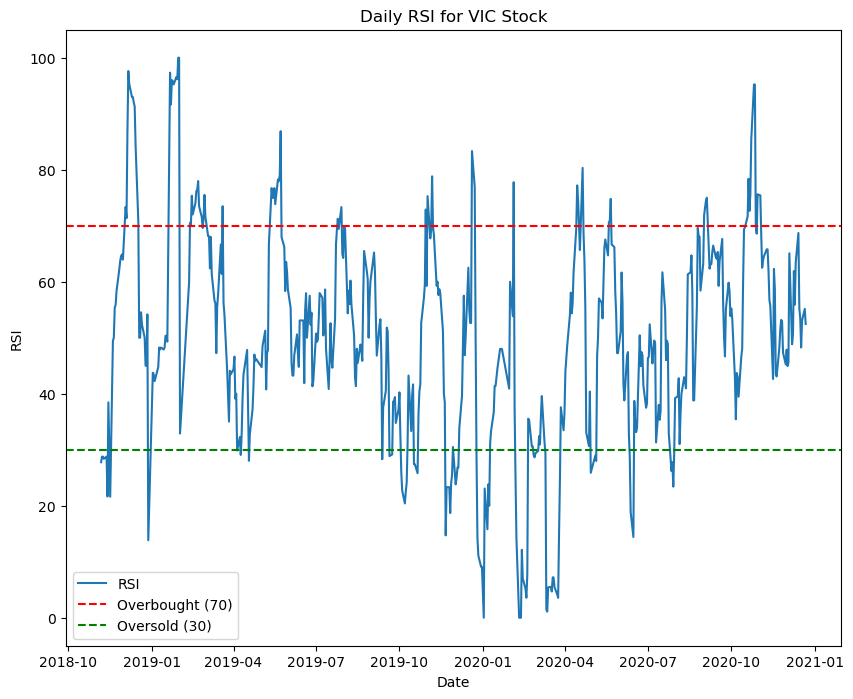

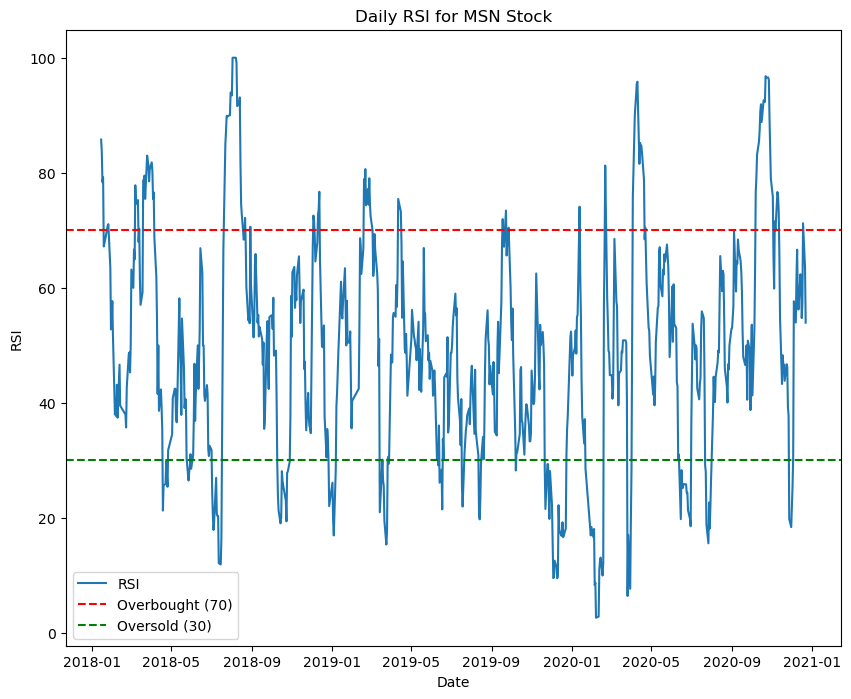

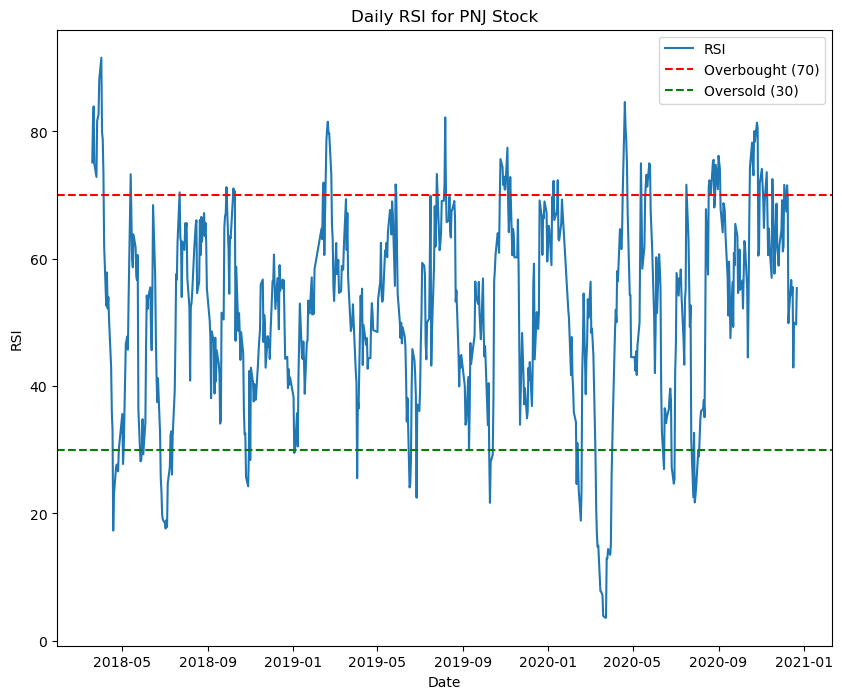

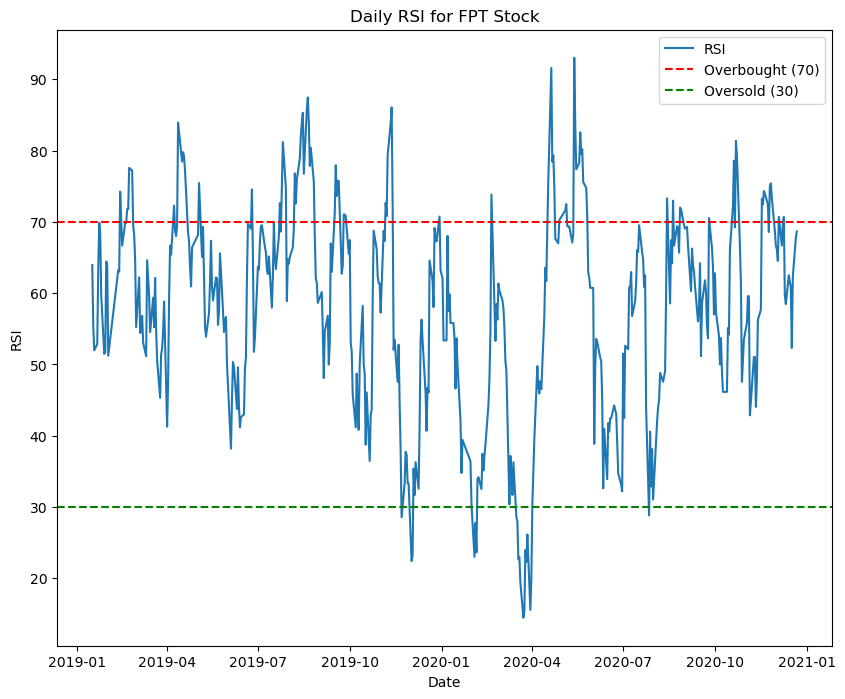

In [22]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

# Define RSI function
def RSI(series, period=14):
    delta = series.diff()
    delta = delta[1:]

    up, down = delta.clip(lower=0), delta.clip(upper=0).abs()

    roll_up = up.rolling(window=period).mean()
    roll_down = down.rolling(window=period).mean()

    RS = roll_up / roll_down
    RSI = 100 - (100 / (1.0 + RS))

    RSI[:] = np.select([roll_down == 0, roll_up == 0], [100, 0], default=RSI)
    RSI.name = 'RSI'

    valid_RSI = RSI[RSI.notnull()]

    return valid_RSI

# Define a function to group by day and calculate RSI
def process_and_plot(files):
    for key in files.keys():
        df = files[key]
        
        # Resample to daily frequency and calculate daily metrics
        df_daily = df.resample('D').agg({
            'Open': 'first',
            'High': 'max',
            'Low': 'min',
            'Close': 'last',
            'Volume': 'sum'
        })
        df_daily.dropna(inplace=True)

        # Calculate RSI
        rsi_series = RSI(df_daily['Close'])

        # Create a new figure for each plot
        plt.figure(figsize=(10, 8))
        
        # Plot RSI
        plt.plot(rsi_series.index, rsi_series, label='RSI')
        plt.axhline(70, color='r', linestyle='--', label='Overbought (70)')
        plt.axhline(30, color='g', linestyle='--', label='Oversold (30)')
        
        # Customize plot
        plt.title(f'Daily RSI for {key.upper()} Stock')
        plt.xlabel('Date')
        plt.ylabel('RSI')
        plt.legend()
        
        # Display the plot
        plt.show()

# Define files dictionary with DataFrames
files = {
    'vic': vic, 
    'msn': msn, 
    'pnj': pnj, 
    'fpt': fpt
}

# Process and plot RSI for each file
process_and_plot(files)


In [23]:
vic

,Ticker,Open,High,Low,Close,Volume,Price_Movement,Return
Date/Time,,,,,,,,
2018-10-17 09:39:00,VIC,98.5,98.5,98.5,98.5,390,0.0,NaN
2018-10-17 09:40:00,VIC,98.5,98.5,98.5,98.5,760,0.1,0.000000
2018-10-17 09:41:00,VIC,98.6,98.6,98.6,98.6,2060,0.0,0.101523
2018-10-17 09:42:00,VIC,98.6,98.6,98.6,98.6,5540,0.1,0.000000
2018-10-17 09:43:00,VIC,98.6,98.7,98.6,98.7,760,0.0,0.101420
...,...,...,...,...,...,...,...,...
2020-12-22 14:22:00,VIC,105.8,105.8,105.7,105.7,1870,0.0,-0.094518
2020-12-22 14:23:00,VIC,105.7,105.7,105.7,105.7,2510,0.0,0.000000
2020-12-22 14:24:00,VIC,105.7,105.7,105.7,105.7,3620,0.0,0.000000


<Figure size 2000x1200 with 0 Axes>

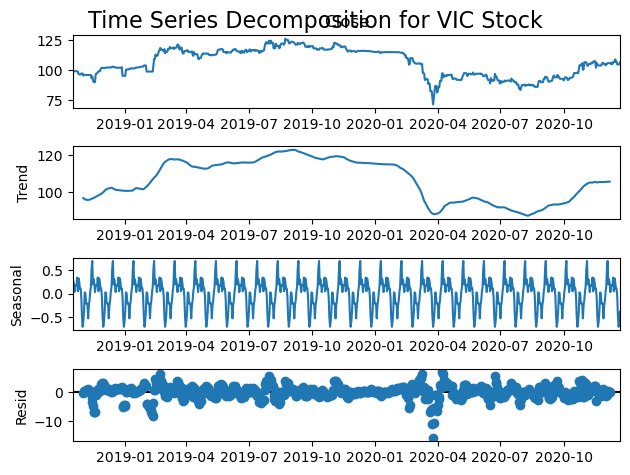

<Figure size 2000x1200 with 0 Axes>

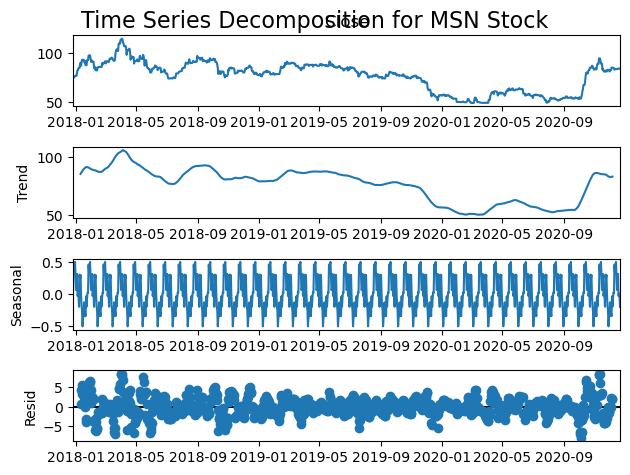

<Figure size 2000x1200 with 0 Axes>

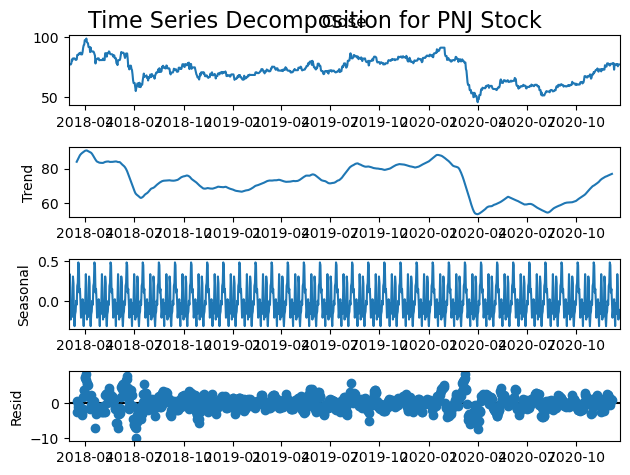

<Figure size 2000x1200 with 0 Axes>

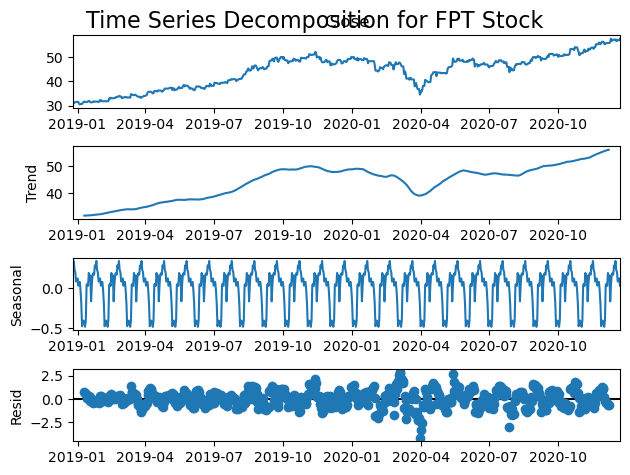

In [24]:
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.seasonal import seasonal_decompose

# Function to decompose and plot time series for each stock
def decompose_and_plot(files):
    for key in files.keys():
        df = files[key]
        
        # Resample the data to daily frequency
        df_daily = df.resample('D').ffill()
        
        # Drop rows with missing values in the 'Close' column
        df_daily = df_daily.dropna(subset=['Close'])
        
        # Check if there's enough data to decompose
        if len(df_daily) > 30:  # Ensure there's at least 30 days of data
            # Decompose the time series
            decomposition = seasonal_decompose(df_daily['Close'], model='additive', period=30)
            
            # Plot the decomposed components
            plt.figure(figsize=(20, 12))
            decomposition.plot()
            plt.suptitle(f'Time Series Decomposition for {key.upper()} Stock', fontsize=16)
            plt.show()
        else:
            print(f"Not enough data to decompose for {key.upper()} stock.")

# Apply the decomposition to the four stock files
decompose_and_plot(files)


## Build models

#### LSTM

#### Why Use LSTM in This Project?

LSTM (Long Short-Term Memory) networks are particularly suitable for this project due to their ability to handle sequential data and capture long-term dependencies. Here’s why LSTM is a good fit:

1. **Sequential Data Handling**: LSTM is designed to work with sequences of data, making it ideal for time series forecasting where the prediction of future values depends on past observations.

2. **Long-Term Dependencies**: Traditional RNNs struggle with long-term dependencies due to the vanishing gradient problem. LSTM networks, with their gating mechanisms, can maintain and utilize information over extended periods, improving prediction accuracy for tasks involving complex temporal patterns.

3. **Modeling Price Movements**: In financial time series data, such as stock prices, historical price movements influence future prices. LSTMs can effectively learn these patterns from historical data, making them well-suited for predicting price changes and trends.

4. **Avoiding Gradient Issues**: LSTMs mitigate issues related to gradient vanishing and exploding, which are common in standard RNNs. This allows for more stable training and better performance on long sequences.

In summary, using LSTM for this project enhances the model's ability to understand and predict based on historical price data, leading to potentially more accurate and reliable forecasts.


In [25]:
# Function to preprocess data for LSTM
def preprocess_data(df, features, n_steps=50):
    scaler = MinMaxScaler(feature_range=(0, 1))
    scaled_data = scaler.fit_transform(df[features])
    
    X, y = [], []
    for i in range(n_steps, len(scaled_data)):
        X.append(scaled_data[i-n_steps:i])
        y.append(scaled_data[i, -1])
        
    X, y = np.array(X), np.array(y)
    return X, y, scaler

# Example usage: Preprocessing data for all tickers
def prepare_data(files, features, n_steps=50):
    X_train, X_test = [], {}
    y_train, y_test = [], {}
    scalers = {}

    for ticker, df in files.items():
        X, y, scaler = preprocess_data(df, features, n_steps=n_steps)
        train_size = int(len(X) * 0.8)
        
        X_train.append(X[:train_size])
        y_train.append(y[:train_size])
        X_test[ticker] = X[train_size:]
        y_test[ticker] = y[train_size:]
        scalers[ticker] = scaler

    return np.vstack(X_train), np.concatenate(y_train), X_test, y_test, scalers

# Initial feature: 'Price Change'
features = ['Price_Movement']
X_train, y_train, X_test, y_test, scalers = prepare_data(files, features)


In [26]:
# Function to build the LSTM model
def build_lstm_model(input_shape, lstm_units=50, learning_rate=0.001):
    model = Sequential()
    model.add(LSTM(lstm_units, return_sequences=True, input_shape=input_shape))
    model.add(LSTM(lstm_units // 2))
    model.add(Dense(1))
    
    model.compile(optimizer='adam', loss='mean_squared_error')
    return model

# Create and compile the model
lstm_model = build_lstm_model((X_train.shape[1], X_train.shape[2]))
lstm_model.summary()


c:\Users\ASUS\anaconda3\lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm (LSTM)                     │ (None, 50, 50)         │        10,400 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_1 (LSTM)                   │ (None, 25)             │         7,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 1)              │            26 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 18,026 (70.41 KB)

 Trainable params: 18,026 (70.41 KB)

 Non-trainable params: 0 (0.00 B)

In [27]:
# Callbacks setup for model training
def setup_callbacks():
    checkpoint = ModelCheckpoint('best_model.keras', monitor='val_loss', save_best_only=True, mode='min', verbose=1)
    reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=3, min_lr=0.00001, verbose=1)
    return [checkpoint, reduce_lr]

# Train the model with adjusted batch size and fewer epochs to test
callbacks = setup_callbacks()
history = lstm_model.fit(X_train, y_train, validation_split=0.1, epochs=10, batch_size=128, callbacks=callbacks)


Epoch 1/10
2582/2583 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - loss: 0.0074
Epoch 1: val_loss improved from inf to 0.00043, saving model to best_model.keras
2583/2583 ━━━━━━━━━━━━━━━━━━━━ 185s 69ms/step - loss: 0.0073 - val_loss: 4.2711e-04 - learning_rate: 0.0010
Epoch 2/10
2583/2583 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - loss: 0.0016
Epoch 2: val_loss did not improve from 0.00043
2583/2583 ━━━━━━━━━━━━━━━━━━━━ 152s 59ms/step - loss: 0.0016 - val_loss: 7.7555e-04 - learning_rate: 0.0010
Epoch 3/10
2583/2583 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step - loss: 0.0015
Epoch 3: val_loss did not improve from 0.00043
2583/2583 ━━━━━━━━━━━━━━━━━━━━ 239s 93ms/step - loss: 0.0015 - val_loss: 7.5804e-04 - learning_rate: 0.0010
Epoch 4/10
2583/2583 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - loss: 0.0015
Epoch 4: val_loss did not improve from 0.00043

Epoch 4: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.
2583/2583 ━━━━━━━━━━━━━━━━━━━━ 167s 65ms/step - loss: 0.0015 - val_loss: 7.3104e-04 - learning_r

In [28]:
from sklearn.metrics import mean_squared_error

# Evaluate the model using test data
def evaluate_model(model, scalers, X_test, y_test):
    for ticker, X in X_test.items():
        # Predict and check for NaN or infinity in predictions
        y_pred = model.predict(X)
        if np.isnan(y_pred).any() or np.isinf(y_pred).any():
            print(f'Predictions for {ticker} contain NaN or infinity values. Replacing with 0.')
            y_pred = np.nan_to_num(y_pred)  # Replace NaN and inf with 0

        # Inverse transform predictions and true values
        try:
            y_pred = scalers[ticker].inverse_transform(y_pred)
            y_true = scalers[ticker].inverse_transform(y_test[ticker].reshape(-1, 1))
        except ValueError as e:
            print(f'Error during inverse_transform for {ticker}: {e}')
            continue

        # Check for NaN or infinity in the transformed data
        if np.isnan(y_true).any() or np.isinf(y_true).any():
            y_true = np.nan_to_num(y_true)  # Replace NaN and inf with 0

        # Compute RMSE
        rmse = np.sqrt(mean_squared_error(y_true, y_pred))
        print(f'RMSE for {ticker}: {rmse}')

# Call the evaluation function
evaluate_model(lstm_model, scalers, X_test, y_test)


633/633 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step
RMSE for vic: 0.19960272080704886
846/846 ━━━━━━━━━━━━━━━━━━━━ 7s 8ms/step
RMSE for msn: 0.27397654000612676
783/783 ━━━━━━━━━━━━━━━━━━━━ 6s 8ms/step
RMSE for pnj: 0.15978845615689852
609/609 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step
RMSE for fpt: 0.08572986282379719


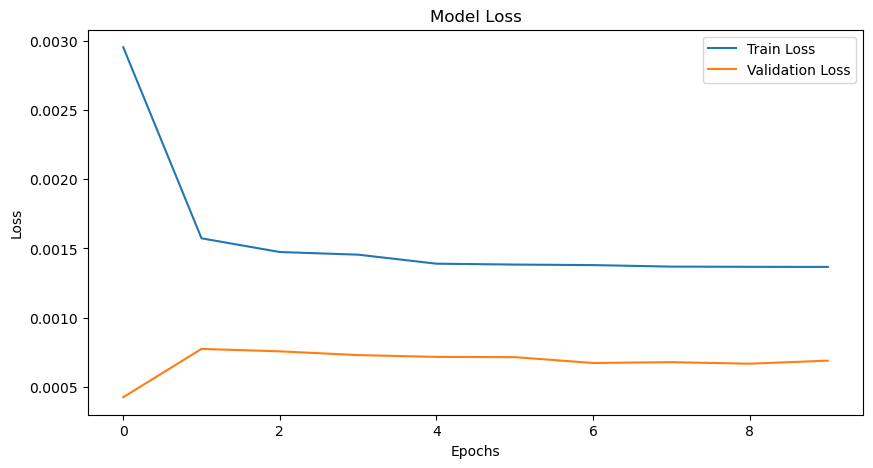

In [29]:
# Function to plot training history
def plot_history(history):
    plt.figure(figsize=(10, 5))
    plt.plot(history.history['loss'], label='Train Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    plt.title('Model Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.show()

plot_history(history)


c:\Users\ASUS\anaconda3\lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



Epoch 1/10
1291/1292 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - loss: 0.0056
Epoch 1: val_loss did not improve from 0.00043
1292/1292 ━━━━━━━━━━━━━━━━━━━━ 87s 65ms/step - loss: 0.0056 - val_loss: 4.2742e-04 - learning_rate: 0.0010
Epoch 2/10
1291/1292 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - loss: 0.0022
Epoch 2: val_loss did not improve from 0.00043
1292/1292 ━━━━━━━━━━━━━━━━━━━━ 86s 66ms/step - loss: 0.0022 - val_loss: 8.2986e-04 - learning_rate: 0.0010
Epoch 3/10
1291/1292 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - loss: 0.0016
Epoch 3: val_loss did not improve from 0.00043
1292/1292 ━━━━━━━━━━━━━━━━━━━━ 85s 66ms/step - loss: 0.0016 - val_loss: 5.8704e-04 - learning_rate: 0.0010
Epoch 4/10
1291/1292 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step - loss: 0.0015
Epoch 4: val_loss did not improve from 0.00043

Epoch 4: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.
1292/1292 ━━━━━━━━━━━━━━━━━━━━ 98s 76ms/step - loss: 0.0015 - val_loss: 7.3729e-04 - learning_rate: 0.0010
Epoch 5/10
1291/1292 ━━━━━

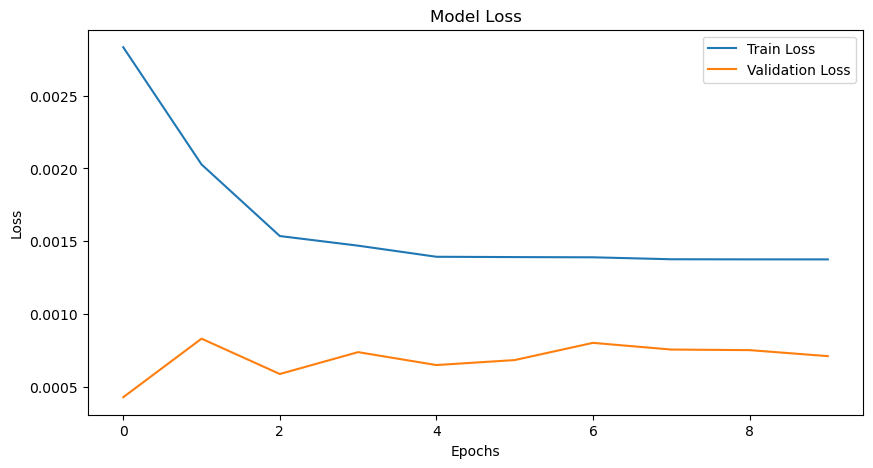

In [30]:
# Try with multiple features
features = ['Open', 'High', 'Low', 'Close', 'Volume', 'Price_Movement']
X_train, y_train, X_test, y_test, scalers = prepare_data(files, features)

# Rebuild the LSTM model with the new features
lstm_model = build_lstm_model((X_train.shape[1], X_train.shape[2]))

# Train again with new feature set
history = lstm_model.fit(X_train, y_train, validation_split=0.1, epochs=10, batch_size=256, callbacks=callbacks)

# Evaluate the new model
evaluate_model(lstm_model, scalers, X_test, y_test)

# Plot new history
plot_history(history)


#### Machine Learning model

In [31]:
# import pandas as pd
# import numpy as np
# from sklearn.linear_model import LinearRegression, SGDRegressor
# from xgboost import XGBRegressor
# from sklearn.metrics import mean_squared_error


# # Define features and target
# features = ['Open', 'High', 'Low', 'Close', 'Volume']
# target = 'Price_Movement'

# # Function to split data and flatten time-series
# def data_split(df, n_steps, features, target):
#     # Dummy implementation for splitting; replace with your actual logic
#     # Create a rolling window of features
#     X, y = [], []
#     for i in range(n_steps, len(df)):
#         X.append(df[features].iloc[i-n_steps:i].values.flatten())
#         y.append(df[target].iloc[i])
#     X = np.array(X)
#     y = np.array(y)
#     return X, y

# # Define regressors
# regressors = {
#     'LinearRegression': LinearRegression(),
#     'SGDRegressor': SGDRegressor(max_iter=4000),
#     'XGBRegressor': XGBRegressor()
# }

# # Function to evaluate models
# def model_evaluate(model, X_test, y_test):
#     y_pred = model.predict(X_test)
#     mse = mean_squared_error(y_test, y_pred)
#     rmse = np.sqrt(mse)
#     return rmse

# # Train and evaluate models for each file
# for ticker, df in files.items():
#     # Drop rows with missing 'Price_Movement' values
#     df.dropna(subset=[target], inplace=True)
    
#     # Split data and flatten time-series
#     X, y = data_split(df, n_steps=30, features=features+[target], target=target)
    
#     # Split into training and validation sets
#     split_idx = int(len(X) * 0.8)  # 80% train, 20% test
#     X_train, X_val = X[:split_idx], X[split_idx:]
#     y_train, y_val = y[:split_idx], y[split_idx:]
    
#     print(f"Evaluating models for ticker: {ticker}")
    
#     for name, reg in regressors.items():
#         print(name)
#         reg.fit(X_train, y_train)
#         rmse = model_evaluate(reg, X_val, y_val)
#         print(f"RMSE: {rmse}")
#         print('-' * 80)


In [32]:
import pandas as pd
import numpy as np
from sklearn.linear_model import LinearRegression, SGDRegressor
from xgboost import XGBRegressor
from sklearn.metrics import mean_squared_error

# Define features and target
features = ['Open', 'High', 'Low', 'Close', 'Volume']
target = 'Price_Movement'

# Function to split data and flatten time-series
def data_split(df, n_steps, features, target):
    X, y = [], []
    for i in range(n_steps, len(df)):
        X.append(df[features].iloc[i-n_steps:i].values.flatten())
        y.append(df[target].iloc[i])
    X = np.array(X)
    y = np.array(y)
    return X, y

# Define regressors with adjusted hyperparameters
regressors = {
    'LinearRegression': LinearRegression(),
    'SGDRegressor': SGDRegressor(max_iter=1000, tol=1e-4),  # Reduced max_iter for faster training
    'XGBRegressor': XGBRegressor(n_estimators=100, max_depth=5, learning_rate=0.1)  # Adjusted hyperparameters
}

# Function to evaluate models
def model_evaluate(model, X_test, y_test):
    y_pred = model.predict(X_test)
    mse = mean_squared_error(y_test, y_pred)
    rmse = np.sqrt(mse)
    return rmse

# Train and evaluate models for each file
for ticker, df in files.items():
    # Drop rows with missing 'Price_Movement' values
    df.dropna(subset=[target], inplace=True)
    
    # Split data and flatten time-series
    X, y = data_split(df, n_steps=15, features=features+[target], target=target)  # Reduced n_steps
    
    # Split into training and validation sets
    split_idx = int(len(X) * 0.8)  # 80% train, 20% test
    X_train, X_val = X[:split_idx], X[split_idx:]
    y_train, y_val = y[:split_idx], y[split_idx:]
    
    print(f"Evaluating models for ticker: {ticker}")
    
    for name, reg in regressors.items():
        print(name)
        reg.fit(X_train, y_train)
        rmse = model_evaluate(reg, X_val, y_val)
        print(f"RMSE: {rmse}")
        print('-' * 80)


Evaluating models for ticker: vic
LinearRegression
RMSE: 0.19104997258783557
--------------------------------------------------------------------------------
SGDRegressor
RMSE: 9.610272875335037e+17
--------------------------------------------------------------------------------
XGBRegressor
RMSE: 0.19073069141686028
--------------------------------------------------------------------------------
Evaluating models for ticker: msn
LinearRegression
RMSE: 0.25801304482029236
--------------------------------------------------------------------------------
SGDRegressor
RMSE: 1.652944070223077e+19
--------------------------------------------------------------------------------
XGBRegressor
RMSE: 0.258140058137304
--------------------------------------------------------------------------------
Evaluating models for ticker: pnj
LinearRegression
RMSE: 0.1682345501612459
--------------------------------------------------------------------------------
SGDRegressor
RMSE: 1.2743778990810546e+17
---